<a href="https://colab.research.google.com/github/vivek6311/Artificial-Intelligence-with-Python/blob/master/Civil_War_in_Asian_Countries_ACLED.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Complted by Vivek Kumar
I have used the Asia Conflict data from Kaggle. 
The ACLED Asia conflict dataset is a comprehensive collection of information on all reported political violence and protest events in Asia since 2010 till 2018. It contains data on various types of conflicts, including riots/protests, battles, and violence against civilians, and covers countries across the continent.

The dataset tells a story of a region grappling with multiple conflicts, both internal and external. From the ongoing war in Syria to the Rohingya crisis in Myanmar, Asia has been a hotbed of conflict in recent years. The ACLED data highlights the intensity and frequency of these conflicts and their impact on the people and nations involved.

In [9]:
#Import important Commands
import numpy as np
import pandas as pd
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm

In [10]:
df=pd.read_csv("/content/asia_conflicts.csv")#,encoding = "ISO-8859-1")

In [11]:
df

,data_id,iso,event_id_cnty,event_id_no_cnty,event_date,year,time_precision,event_type,actor1,assoc_actor_1,...,location,latitude,longitude,geo_precision,source,source_scale,notes,fatalities,timestamp,iso3
0,1732988,50,BNG6787,6787.0,28 July 2018,2018,1,Riots/Protests,Protesters (Bangladesh),Labour Group (Bangladesh),...,Chittagong,22.3571,91.7823,1,The Daily Star (Bangladesh),National,"On July 28, in Faujdarhat area of Chittagong c...",0,1532986405,BGD
1,1733345,356,IND33731,33731.0,28 July 2018,2018,1,Violence against civilians,CPI (Maoist): Communist Party of India (Maoist),NaN,...,Gudem Kotha Veedhi,17.8635,82.1959,1,Hindustan Times,National,"On July 28, a ""tribal"" man was allegedly kille...",1,1532986405,IND
2,1733346,356,IND33732,33732.0,28 July 2018,2018,1,Violence against civilians,CPI (Maoist): Communist Party of India (Maoist),NaN,...,Gudem Kotha Veedhi,17.8619,82.1970,1,Hindustan Times,National,"On July 28, in the Chukka Goyyi area of Gudem ...",1,1532986405,IND
3,1733347,356,IND33733,33733.0,28 July 2018,2018,2,Riots/Protests,Protesters (India),ABVP: Akhil Bharatiya Vidyarthi Parishad,...,Chandigarh,30.7362,76.7884,1,Hindustan Times,National,"Published on July 28, the ABVP of Panjab Unive...",0,1532986405,IND
4,1733348,356,IND33734,33734.0,28 July 2018,2018,1,Battle-No change of territory,Military Forces of India (1949-),Police Forces of India (1949-) Border Security...,...,Keri,32.9413,74.5498,2,Early Times (India),National,"On 28 Jul, an Indian solider was injured in cr...",0,1532986405,IND
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
216674,1531160,586,PAK9,9.0,01 January 2010,2010,1,Riots/Protests,Protesters (Pakistan),NaN,...,Hyderabad,25.3942,68.3736,1,Right Vision News,National,Protests occurred in Hyderabad in solidarity w...,0,1524053974,PAK
216675,1531188,586,PAK5,5.0,01 January 2010,2010,2,Strategic development,Police Forces of Pakistan (2008-) Pakistan Ran...,NaN,...,Quetta,30.1999,67.0097,2,Right Vision News,National,Agents of a Pakistani law enforcement agency r...,0,1524053974,PAK
216676,1707379,764,THA1,1.0,01 January 2010,2010,1,Strategic development,Unidentified Armed Group (Thailand),NaN,...,Kadunong,6.6427,101.5531,2,The Nation,National,Property destruction: An unidentified assailan...,0,1531246498,THA
216677,1673081,144,SRI1298,1298.0,01 January 2010,2010,1,Riots/Protests,Protesters (Sri Lanka),UNF: United National Front; SLFP: Sri Lanka Fr...,...,Makavita,5.9666,80.5666,1,Daily Mirror,National,A group of residents from the Makawita area st...,0,1531145065,LKA


In [55]:
df.year

0         2018
1         2018
2         2018
3         2018
4         2018
          ... 
216674    2010
216675    2010
216676    2010
216677    2010
216678    2010
Name: year, Length: 216679, dtype: int64

In [12]:
df.columns

Index(['data_id', 'iso', 'event_id_cnty', 'event_id_no_cnty', 'event_date',
       'year', 'time_precision', 'event_type', 'actor1', 'assoc_actor_1',
       'inter1', 'actor2', 'assoc_actor_2', 'inter2', 'interaction', 'region',
       'country', 'admin1', 'admin2', 'admin3', 'location', 'latitude',
       'longitude', 'geo_precision', 'source', 'source_scale', 'notes',
       'fatalities', 'timestamp', 'iso3'],
      dtype='object')

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 216679 entries, 0 to 216678
Data columns (total 30 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   data_id           216679 non-null  int64  
 1   iso               216679 non-null  int64  
 2   event_id_cnty     216679 non-null  object 
 3   event_id_no_cnty  216671 non-null  float64
 4   event_date        216679 non-null  object 
 5   year              216679 non-null  int64  
 6   time_precision    216679 non-null  int64  
 7   event_type        216679 non-null  object 
 8   actor1            216679 non-null  object 
 9   assoc_actor_1     65593 non-null   object 
 10  inter1            216679 non-null  int64  
 11  actor2            113932 non-null  object 
 12  assoc_actor_2     20516 non-null   object 
 13  inter2            216679 non-null  int64  
 14  interaction       216679 non-null  int64  
 15  region            216679 non-null  object 
 16  country           21

In [14]:
df.isna().sum()

data_id                  0
iso                      0
event_id_cnty            0
event_id_no_cnty         8
event_date               0
year                     0
time_precision           0
event_type               0
actor1                   0
assoc_actor_1       151086
inter1                   0
actor2              102747
assoc_actor_2       196163
inter2                   0
interaction              0
region                   0
country                  0
admin1                   1
admin2                 830
admin3               68959
location                 1
latitude                 0
longitude                0
geo_precision            0
source                   0
source_scale             4
notes                    0
fatalities               0
timestamp                0
iso3                     3
dtype: int64

# Countries with the highest number of fatalities.

In [15]:
# Aggregate the data by country and sum the fatalities
deaths = df.groupby('country')['fatalities'].sum().reset_index()

# Sort the data in decreasing order of fatalities and select the top 10
death_data = deaths.sort_values(by='fatalities', ascending=False).iloc[:10]

print(death_data)

         country  fatalities
0    Afghanistan       73591
7           Iraq       73572
22         Syria       72000
27         Yemen       48626
16      Pakistan       35110
24        Turkey        9454
20  Saudi Arabia        7058
18   Philippines        7057
13       Myanmar        5740
4          India        3132


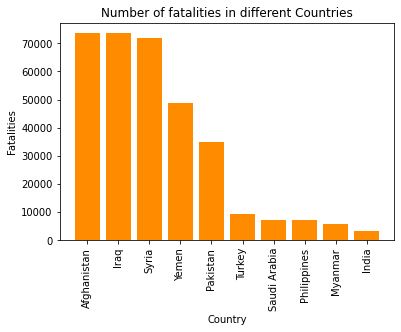

In [16]:
colors = range(len(death_data))
# Create a bar plot of the data using the color map
fig, ax = plt.subplots()
ax.bar(death_data['country'], death_data['fatalities'], color='darkorange')
# Set axis labels and title
plt.xlabel("Country")
plt.ylabel("Fatalities")
plt.title("Number of fatalities in different Countries")

# Rotate x-axis labels to avoid overlapping
plt.xticks(rotation=90)

# Display the plot
plt.show()


# Fatalities grouped by region 

In [17]:
# Aggregate data by region and country, and sort in descending order
region_data = df.groupby(['region', 'country'])['fatalities'].sum().reset_index().sort_values('fatalities', ascending=False)

# Remove rows where fatalities == 0
region_data = region_data[region_data.fatalities != 0]
print(region_data)

                region       country  fatalities
23       Southern Asia   Afghanistan       73591
2          Middle East          Iraq       73572
11         Middle East         Syria       72000
14         Middle East         Yemen       48626
27       Southern Asia      Pakistan       35110
12         Middle East        Turkey        9454
10         Middle East  Saudi Arabia        7058
20  South-Eastern Asia   Philippines        7057
19  South-Eastern Asia       Myanmar        5740
25       Southern Asia         India        3132
24       Southern Asia    Bangladesh        2033
21  South-Eastern Asia      Thailand        1381
6          Middle East       Lebanon         697
1          Middle East          Iran         519
8          Middle East     Palestine         513
16  South-Eastern Asia      Cambodia         221
26       Southern Asia         Nepal         168
17  South-Eastern Asia     Indonesia         152
28       Southern Asia     Sri Lanka         137
22  South-Eastern As

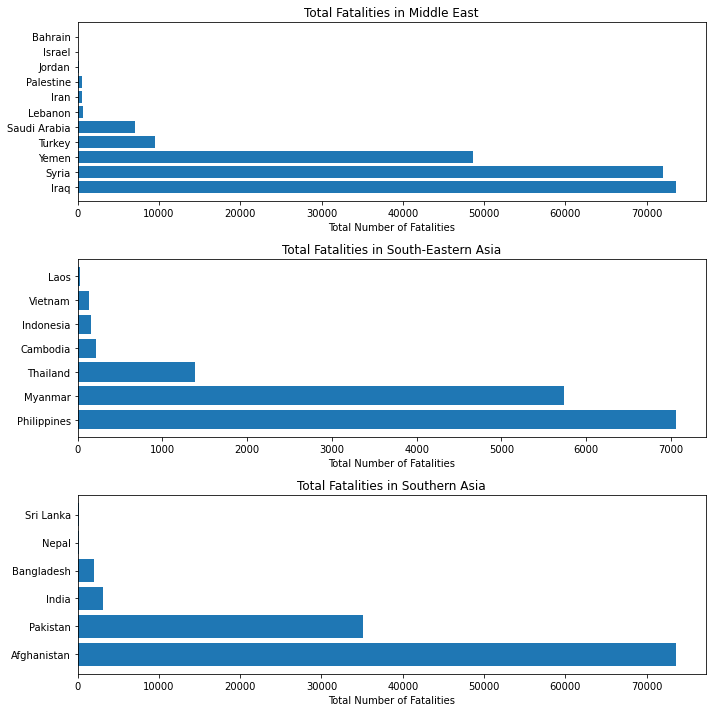

In [18]:
# Group data by region
grouped_data = region_data.groupby('region')
# Create a subplot for each region
fig, axes = plt.subplots(nrows=len(grouped_data), figsize=(10,10))
# Create a bar plot for each region
for i, (region, group) in enumerate(grouped_data):
    ax = axes[i]
    ax.barh(np.arange(len(group)), group['fatalities'])
    ax.set_yticks(np.arange(len(group)))
    ax.set_yticklabels(group['country'])
    ax.set_xlabel('Total Number of Fatalities')
    ax.set_title(f'Total Fatalities in {region}')

plt.tight_layout()
plt.show()

# countries with most number of conflicts

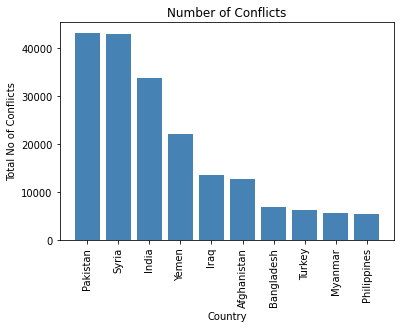

In [19]:
# Compute the counts of conflicts by country
counts = df['country'].value_counts().reset_index()
counts.columns = ['country', 'conflicts']

# Sort the data in descending order of number of conflicts and select the top 10
counts_data = counts.sort_values('conflicts', ascending=False).head(10)

# Create the bar plot
plt.bar(x=counts_data['country'], height=counts_data['conflicts'], color='steelblue')
plt.xticks(rotation=90, ha='center')
plt.xlabel('Country')
plt.ylabel('Total No of Conflicts')
plt.title('Number of Conflicts')
plt.show()


# Event Related Conflicts


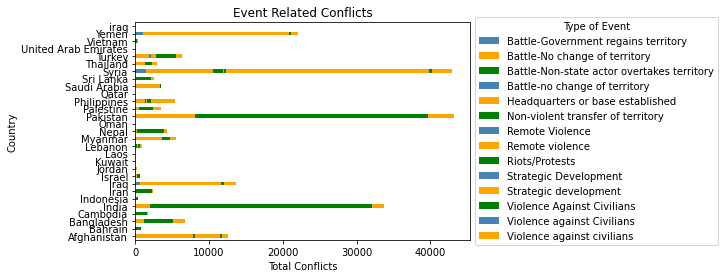

In [20]:
# Frequency of event types by country
event_data = df.groupby(['country', 'event_type']).size().reset_index()
event_data.columns = ['country', 'event_type', 'frequency']

# Horizontal stacked bar plot
pivot = event_data.pivot(index='country', columns='event_type', values='frequency')
pivot.plot(kind='barh', stacked=True, color=['steelblue', 'orange', 'green'])
plt.xlabel('Total Conflicts')
plt.ylabel('Country')
plt.title('Event Related Conflicts')
plt.legend(title='Type of Event', loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.show()

# Top 20 active Actors in Conflicts

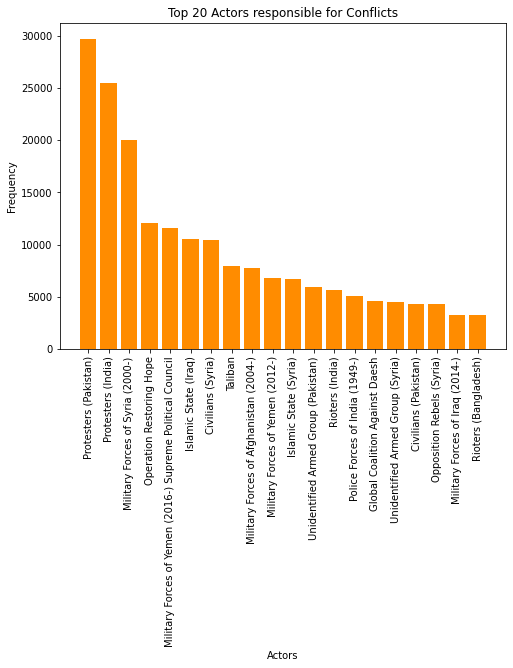

In [21]:
# Get counts of Actor1 and Actor2 and combine into one dataframe
act1 = pd.DataFrame(df['actor1'].value_counts()).reset_index()
act1.columns = ['actor', 'freq']
act2 = pd.DataFrame(df['actor2'].value_counts()).reset_index()
act2.columns = ['actor', 'freq']
actors = pd.concat([act1, act2], ignore_index=True)

# Aggregate the frequencies by actor
act_data = actors.groupby('actor').sum().reset_index()
act_data = act_data.sort_values(by='freq', ascending=False)

# Create bar plot
plt.figure(figsize=(8, 6))
plt.bar(x=act_data['actor'][:20], height=act_data['freq'][:20], color='darkorange')
plt.xticks(rotation=90)
plt.xlabel('Actors')
plt.ylabel('Frequency')
plt.title('Top 20 Actors responsible for Conflicts')
plt.show()


# Areas with most number of Riots/Protests

In [ ]:
import folium

riot_protest = df[df['event_type'] == 'Riots/Protests']
map = folium.Map(location=[0, 0], zoom_start=2)
for lat, lon, fatality in zip(riot_protest['latitude'], riot_protest['longitude'], riot_protest['fatalities']):
    folium.CircleMarker(
        location=[lat, lon],
        radius=fatality,
        color='#084081',
        fill=True,
        fill_color='#084081'
    ).add_to(map)

map

# Active countries for Riots/Protests.

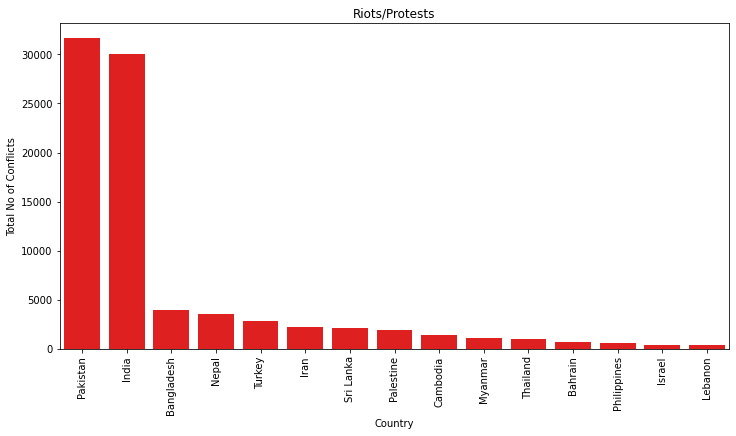

In [38]:
rp_countries = df[df['event_type'] == 'Riots/Protests']
rp_countries = rp_countries.groupby('country').size().reset_index(name='freq')
rp_countries = rp_countries.sort_values('freq', ascending=False)

plt.figure(figsize=(12,6))
sns.barplot(x='country', y='freq', data=rp_countries[:15], color='red')
plt.xticks(rotation=90)
plt.xlabel('Country')
plt.ylabel('Total No of Conflicts')
plt.title('Riots/Protests')
plt.show()

# Areas with most number of Violence against Civilians

In [39]:
import folium

civilians = df[df['event_type'] == 'Violence against civilians']
m = folium.Map(location=[civilians['latitude'].mean(), civilians['longitude'].mean()], zoom_start=4, tiles='Stamen Terrain')

for index, row in civilians.iterrows():
    folium.CircleMarker(location=[row['latitude'], row['longitude']], radius=row['fatalities'],
                        color='#084081', fill=True, fill_opacity=0.7).add_to(m)
    
m


In [40]:
import folium

civilians = df[df['event_type'] == 'Violence against civilians']

# create a map centered on the mean latitude and longitude of the events
map_civilians = folium.Map(location=[civilians['latitude'].mean(), civilians['longitude'].mean()], zoom_start=5)

# add circles for each event, with radius proportional to fatalities and color set to blue
for index, row in civilians.iterrows():
    folium.Circle(location=[row['latitude'], row['longitude']], radius=row['fatalities'], color='#084081').add_to(map_civilians)

# show the map
map_civilians


# Name of Countries for violence against civilians


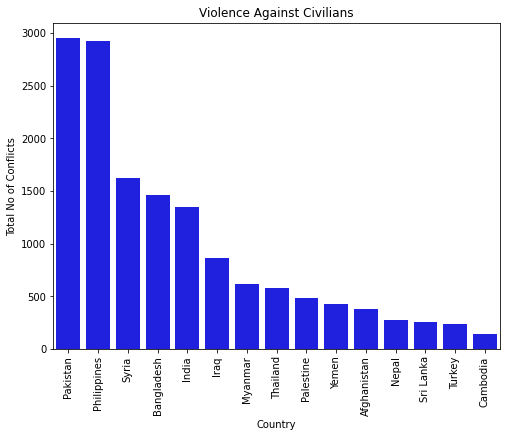

In [41]:
civilians_countries = civilians.groupby('country').size().reset_index(name='freq')
civilians_countries = civilians_countries.sort_values('freq', ascending=False).reset_index(drop=True)

plt.figure(figsize=(8,6))
sns.barplot(x='country', y='freq', data=civilians_countries.iloc[:15], color='blue')
plt.xticks(rotation=90)
plt.xlabel('Country')
plt.ylabel('Total No of Conflicts')
plt.title('Violence Against Civilians')
plt.show()

# Random Forest

In [42]:
df.columns

Index(['data_id', 'iso', 'event_id_cnty', 'event_id_no_cnty', 'event_date',
       'year', 'time_precision', 'event_type', 'actor1', 'assoc_actor_1',
       'inter1', 'actor2', 'assoc_actor_2', 'inter2', 'interaction', 'region',
       'country', 'admin1', 'admin2', 'admin3', 'location', 'latitude',
       'longitude', 'geo_precision', 'source', 'source_scale', 'notes',
       'fatalities', 'timestamp', 'iso3'],
      dtype='object')

In [43]:
df1= df[["event_type", "region", "latitude", "longitude", "year", "fatalities",'country']]
print(df1)

                           event_type              region  latitude  \
0                      Riots/Protests       Southern Asia   22.3571   
1          Violence against civilians       Southern Asia   17.8635   
2          Violence against civilians       Southern Asia   17.8619   
3                      Riots/Protests       Southern Asia   30.7362   
4       Battle-No change of territory       Southern Asia   32.9413   
...                               ...                 ...       ...   
216674                 Riots/Protests       Southern Asia   25.3942   
216675          Strategic development       Southern Asia   30.1999   
216676          Strategic development  South-Eastern Asia    6.6427   
216677                 Riots/Protests       Southern Asia    5.9666   
216678     Violence against civilians  South-Eastern Asia   16.0408   

        longitude  year  fatalities     country  
0         91.7823  2018           0  Bangladesh  
1         82.1959  2018           1       India

In [44]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier


In [45]:
# Convert categorical features to numerical using one-hot encoding
#df = pd.get_dummies(df, columns=[ "region"])
df1 = pd.get_dummies(df1, columns=["event_type", "region"])

In [47]:
features = list(df1.columns)

In [46]:
# Load the ACLED dataset
#acled = pd.read_csv("path/to/acled_dataset.csv")

# Select features and target variable
features = df1.columns
target = "country"

In [48]:
X = df1[features].drop('country',axis=1).dropna()
y=df1['country'].dropna()

In [49]:
X.shape,y.shape

((216679, 21), (216679,))

In [50]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [51]:
X_train.shape

(173343, 21)

In [52]:
# Train a random forest classifier
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Evaluate the model on the test set
accuracy = rf.score(X_test, y_test)
print(f"Random Forest Accuracy: {accuracy*100}")

Random Forest Accuracy: 99.62386930035075
